# General imports

In [1]:
import os,sys, glob,shutil
import numpy as np
import matplotlib.pyplot as plt
import tifffile
%matplotlib inline

In [2]:
# this line is so the modules in the next cell get imported. They live in this path.
# Change this to where you cloned ClearMap2
sys.path.append('/jukebox/wang/ahoag/ClearMap2')

## Clearmap specific imports

In [3]:
import ClearMap.IO.Workspace as wsp
import ClearMap.IO.IO as io
import ClearMap.ImageProcessing.Experts.Cells as cells

## Link the corrected z planes to a new folder and in the process rename them to Z0000.tif, Z0001.tif, ...

In [65]:
# symlink files to a new directory with filenames Z0000.tif, Z0001.tif, etc...
# Change the dst_dir to where you want these z planes linked 
src_dir = os.path.join('/jukebox/LightSheetData/lightserv/cz15',
                       'zimmerman_01/zimmerman_01-001/imaging_request_1',
                       'rawdata/resolution_3.6x/Ex_642_Em_2_stitched/corrected')
dst_dir = '' 
src_files = sorted(glob.glob(src_dir + '/*tif'))
for ii,src in enumerate(src_files):
    dst_basename = 'Z' + f'{ii}'.zfill(4) + '.tif'
    dst = os.path.join(dst_dir,dst_basename)
    os.symlink(src,dst)
    
    

In [66]:
pwd

'/mnt/bucket/labs/wang/ahoag/test_clearmap2/notebooks'

# Set up the workspace


In [4]:
directory = os.path.join('/jukebox/wang/ahoag/test_clearmap2/output',
             'cz15/zimmerman_01_smartspim/zimmerman_01-001',
             'imaging_request_1/output/ch647_renamed')

expression_raw      = 'corrected/Z<Z,4>.tif'    

ws = wsp.Workspace('CellMap', directory=directory);
ws.update(raw=expression_raw)
ws.debug=False
ws.info()

Workspace[CellMap]{/jukebox/wang/ahoag/test_clearmap2/output/cz15/zimmerman_01_smartspim/zimmerman_01-001/imaging_request_1/output/ch647_renamed}
              raw: corrected/Z<Z,4>.tif {3589 files, ('Z',): (0,) -> (3588,)}
 autofluorescence: no file
         stitched: stitched.npy
           layout: no file
       background: no file
        resampled: no file
resampled_to_auto: no file
auto_to_reference: no file
            cells: no file
          density: no file



## Verify that the raw data files were corrected read in.
The plot below should show a brain slice and should not be an empty image!

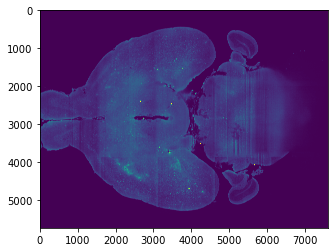

In [68]:
fig=plt.figure()
ax=fig.add_subplot()
z_plane = ws.source('raw')[:,:,2500]
ax.imshow(z_plane,vmin=0,vmax=200)

## created the "stitched" volume -- this just puts the whole brain into a single .npy file
This makes it possible to create smaller subvolumes, which is useful for testing the cell detection down below.

This takes a while to run! ~ 20 mins for me.
Uncomment the lines below and then run the cell once. 

In [7]:
# source = ws.source('raw');
# sink   = ws.filename('stitched')
# io.convert(source, sink, verbose=True) # creates a file called "stitched.npy"

## Make a small subvolume slice to test the cell detection on

In [104]:
ws.debug = 'testchunk' 
slicing = (slice(4000,4500),slice(2000,2500),slice(2450,2480))
ws.create_debug('stitched', slicing=slicing) # creates a file called testchunk_stitched

'/jukebox/wang/ahoag/test_clearmap2/output/cz15/zimmerman_01_smartspim/zimmerman_01-001/imaging_request_1/output/ch647_renamed/testchunk_stitched.npy'

In [105]:
ws.source('stitched').shape # This is the x,y,z shape of the subvolume

(500, 500, 30)

(500, 500)


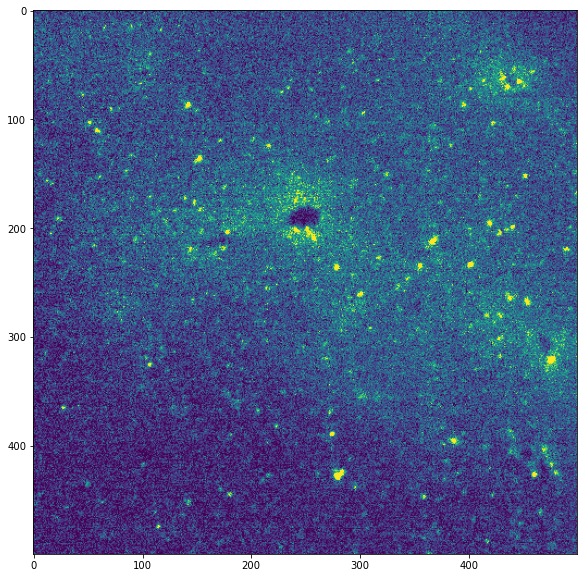

In [106]:
# visually validate that this chunk has tissue and some cells in it
z_plane_to_look_at = 0 # this is z plane of the subvolume we want to look at. Change it to look at other z planes.
stitched_z_plane = ws.source('stitched')[:,:,z_plane_to_look_at] 
print(stitched_z_plane.shape)

fig = plt.figure(figsize=(15,10))
ax=fig.add_subplot(111)
ax.imshow(stitched_z_plane,vmin=0,vmax=200)

# Run the cell detection on this test volume
Just using some initial parameters to make sure we have everything set up properly.

With a subvolume with shape: 500,500,30 the cell detection should only take a few seconds


In [107]:
cell_detection_parameter = cells.default_cell_detection_parameter.copy()
cell_detection_parameter['illumination'] = None
cell_detection_parameter['background_correction']['shape'] = (5,5)
cell_detection_parameter['intensity_detection']['measure'] = ['source','background']
cell_detection_parameter['shape_detection']['threshold'] = 250

io.delete_file(ws.filename('cells', postfix='maxima'))
cell_detection_parameter['maxima_detection']['save'] = ws.filename('cells', postfix='maxima')

processing_parameter = cells.default_cell_detection_processing_parameter.copy()
processing_parameter.update(
    processes = 'serial',
    size_max = 100, #35,
    size_min = 30, #30,
    overlap  = 15, #10,
    verbose = True
    )

cells.detect_cells(ws.filename('stitched'), ws.filename('cells', postfix='raw'),
                   cell_detection_parameter=cell_detection_parameter,
                   processing_parameter=processing_parameter)

Processing 1 blocks with function 'detect_cells_block'.
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Background removal shape: (5, 5)
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Background removal form : Disk
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Background removal save : False
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Illumination correction: elapsed time: 0:00:00.113
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: DoG filter: shape : None
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: DoG filter: sigma : None
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: DoG filter: sigma2: None
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: DoG filter: elapsed time: 0:00:00.000
Block 0/

/usr/people/ahoag/.conda/envs/cm/lib/python3.7/site-packages/skimage/morphology/_deprecated.py:5: skimage_deprecation: Function ``watershed`` is deprecated and will be removed in version 0.19. Use ``skimage.segmentation.watershed`` instead.
  def watershed(image, markers=None, connectivity=1, offset=None, mask=None,


Shape detection: elapsed time: 0:00:00.398
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.856
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: method: max
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: shape : 3
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.496
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Cell detection: elapsed time: 0:00:02.123
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: elapsed time: 0:00:02.338
Processed 1 blocks with function 'detect_cells_block': elapsed time: 0:00:02.481


'/jukebox/wang/ahoag/test_clearmap2/output/cz15/zimmerman_01_smartspim/zimmerman_01-001/imaging_request_1/output/ch647_renamed/testchunk_cells_raw.npy'

This should have saved a file called testchunk_cells_raw.npy in your output directory that you set at the beginning.

## Inspect the distribution of detected cells in the subvolume

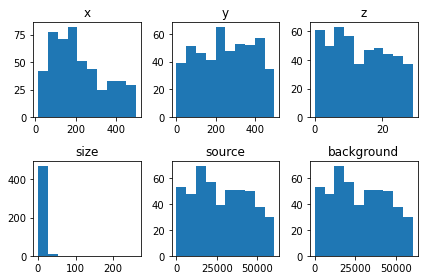

In [108]:
source = ws.source('cells', postfix='raw')

plt.figure(1); plt.clf();
names = source.dtype.names;
nx,ny = 2,3
for i, name in enumerate(names):
    plt.subplot(nx, ny, i+1)
    plt.hist(source[name]);
    plt.title(name)
plt.tight_layout();



## Show cells overlaid on top of tissue to validate cell detection

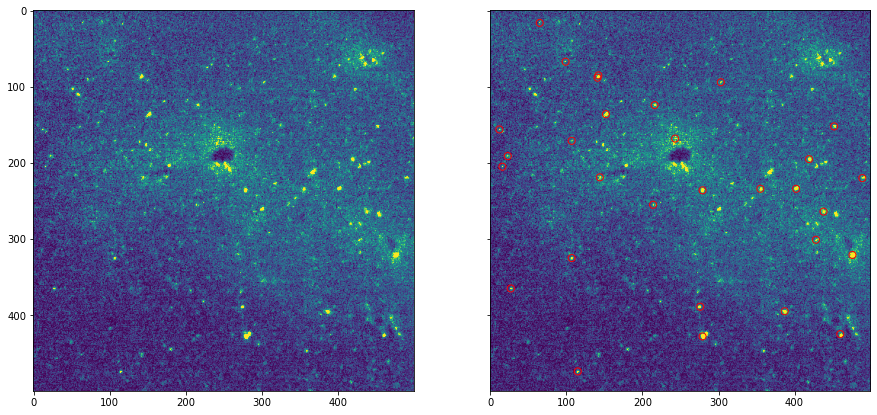

In [109]:
coordinates = np.hstack([ws.source('cells', postfix='raw')[c][:,None] for c in 'xyz']);
this_plane_coords = np.array([coord for coord in coordinates if coord[-1] ==0])
xs = this_plane_coords[:,0]
ys = this_plane_coords[:,1]
fig,axes = plt.subplots(figsize=(15,8),nrows=1,ncols=2,sharex=True,sharey=True)
ax_tissue = axes[0]
ax_tissue.imshow(stitched_z_plane,vmin=0,vmax=200,cmap='viridis')
ax_both=axes[1]
ax_both.imshow(stitched_z_plane,vmin=0,vmax=200,cmap='viridis')
ax_both.scatter(ys,xs,s=50,facecolors='none',edgecolors='r')

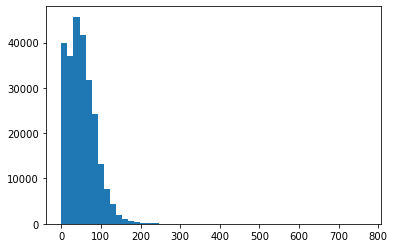

In [110]:
# useful to know what the pixel value distribution looks like for this subchunk
_=plt.hist(ws.source('stitched')[:,:,0].flatten(),bins=50)

## Run the "parameter sweep" 
This runs a loop over a bunch of parameters and saves out a .npy file for each parameter set 

In [111]:
# Here are the parameters we used above:
cell_detection_parameter

{'iullumination_correction': {'flatfield': None, 'scaling': 'mean'},
 'background_correction': {'shape': (5, 5), 'form': 'Disk', 'save': False},
 'equalization': None,
 'dog_filter': {'shape': None, 'sigma': None, 'sigma2': None},
 'maxima_detection': {'h_max': None,
  'shape': 5,
  'threshold': 0,
  'valid': True,
  'save': '/jukebox/wang/ahoag/test_clearmap2/output/cz15/zimmerman_01_smartspim/zimmerman_01-001/imaging_request_1/output/ch647_renamed/testchunk_cells_maxima.npy'},
 'shape_detection': {'threshold': 250, 'save': False},
 'intensity_detection': {'method': 'max',
  'shape': 3,
  'measure': ['source', 'background']},
 'illumination': None,
 'verbose': True}

In [112]:
# Here we list the parameter ranges to sweep over.
background_sizes = [5,7,9] # will make xy tuples like: (5,5), (7,7), (9,9)  
shape_threshold_sizes = [150,250,350]

In [113]:
from itertools import product
for background_size,shape_threshold_size in product(background_sizes,shape_threshold_sizes):
    this_cell_parameter_dict = cell_detection_parameter.copy()
    this_cell_parameter_dict['background_correction']['shape'] = (background_size,background_size)
    this_cell_parameter_dict['shape_detection']['threshold'] = shape_threshold_size
    postfix = f'raw_bck{background_size}_shpthresh{shape_threshold_size}'
#     print(ws.filename('cells', postfix=postfix))
    cells.detect_cells(ws.filename('stitched'), ws.filename('cells', postfix=postfix),
        cell_detection_parameter=this_cell_parameter_dict,
        processing_parameter=processing_parameter)

Processing 1 blocks with function 'detect_cells_block'.
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Background removal shape: (5, 5)
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Background removal form : Disk
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Background removal save : False
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Illumination correction: elapsed time: 0:00:00.118
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: DoG filter: shape : None
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: DoG filter: sigma : None
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: DoG filter: sigma2: None
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: DoG filter: elapsed time: 0:00:00.000
Block 0/

/usr/people/ahoag/.conda/envs/cm/lib/python3.7/site-packages/skimage/morphology/_deprecated.py:5: skimage_deprecation: Function ``watershed`` is deprecated and will be removed in version 0.19. Use ``skimage.segmentation.watershed`` instead.
  def watershed(image, markers=None, connectivity=1, offset=None, mask=None,


Shape detection: elapsed time: 0:00:00.401
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.748
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: method: max
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: shape : 3
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.502
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Cell detection: elapsed time: 0:00:02.010
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: elapsed time: 0:00:02.206
Processed 1 blocks with function 'detect_cells_block': elapsed time: 0:00:02.346
Processing 1 blocks with function 'detect_cells_block'.
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:

/usr/people/ahoag/.conda/envs/cm/lib/python3.7/site-packages/skimage/morphology/_deprecated.py:5: skimage_deprecation: Function ``watershed`` is deprecated and will be removed in version 0.19. Use ``skimage.segmentation.watershed`` instead.
  def watershed(image, markers=None, connectivity=1, offset=None, mask=None,


Shape detection: elapsed time: 0:00:00.396
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.621
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: method: max
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: shape : 3
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.498
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Cell detection: elapsed time: 0:00:01.910
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: elapsed time: 0:00:02.071
Processed 1 blocks with function 'detect_cells_block': elapsed time: 0:00:02.192
Processing 1 blocks with function 'detect_cells_block'.
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:

/usr/people/ahoag/.conda/envs/cm/lib/python3.7/site-packages/skimage/morphology/_deprecated.py:5: skimage_deprecation: Function ``watershed`` is deprecated and will be removed in version 0.19. Use ``skimage.segmentation.watershed`` instead.
  def watershed(image, markers=None, connectivity=1, offset=None, mask=None,


Shape detection: elapsed time: 0:00:00.364
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.718
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: method: max
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: shape : 3
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.473
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Cell detection: elapsed time: 0:00:01.824
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: elapsed time: 0:00:01.978
Processed 1 blocks with function 'detect_cells_block': elapsed time: 0:00:02.098
Processing 1 blocks with function 'detect_cells_block'.
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:

/usr/people/ahoag/.conda/envs/cm/lib/python3.7/site-packages/skimage/morphology/_deprecated.py:5: skimage_deprecation: Function ``watershed`` is deprecated and will be removed in version 0.19. Use ``skimage.segmentation.watershed`` instead.
  def watershed(image, markers=None, connectivity=1, offset=None, mask=None,


Shape detection: elapsed time: 0:00:00.389
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.767
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: method: max
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: shape : 3
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.474
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Cell detection: elapsed time: 0:00:01.968
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: elapsed time: 0:00:02.127
Processed 1 blocks with function 'detect_cells_block': elapsed time: 0:00:02.275
Processing 1 blocks with function 'detect_cells_block'.
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:

/usr/people/ahoag/.conda/envs/cm/lib/python3.7/site-packages/skimage/morphology/_deprecated.py:5: skimage_deprecation: Function ``watershed`` is deprecated and will be removed in version 0.19. Use ``skimage.segmentation.watershed`` instead.
  def watershed(image, markers=None, connectivity=1, offset=None, mask=None,


Shape detection threshold: 250
Shape detection: elapsed time: 0:00:00.358
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.704
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: method: max
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: shape : 3
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.441
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Cell detection: elapsed time: 0:00:01.921
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: elapsed time: 0:00:02.066
Processed 1 blocks with function 'detect_cells_block': elapsed time: 0:00:02.179
Processing 1 blocks with function 'detect_cells_block'.
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]
Block 0/1<(0, 0, 0)/(1, 1, 1)> (

/usr/people/ahoag/.conda/envs/cm/lib/python3.7/site-packages/skimage/morphology/_deprecated.py:5: skimage_deprecation: Function ``watershed`` is deprecated and will be removed in version 0.19. Use ``skimage.segmentation.watershed`` instead.
  def watershed(image, markers=None, connectivity=1, offset=None, mask=None,


Shape detection: elapsed time: 0:00:00.351
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.716
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: method: max
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: shape : 3
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.432
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Cell detection: elapsed time: 0:00:01.818
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: elapsed time: 0:00:01.963
Processed 1 blocks with function 'detect_cells_block': elapsed time: 0:00:02.080
Processing 1 blocks with function 'detect_cells_block'.
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:

/usr/people/ahoag/.conda/envs/cm/lib/python3.7/site-packages/skimage/morphology/_deprecated.py:5: skimage_deprecation: Function ``watershed`` is deprecated and will be removed in version 0.19. Use ``skimage.segmentation.watershed`` instead.
  def watershed(image, markers=None, connectivity=1, offset=None, mask=None,


Shape detection: elapsed time: 0:00:00.380
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.769
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: method: max
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: shape : 3
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.447
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Cell detection: elapsed time: 0:00:01.884
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: elapsed time: 0:00:02.037
Processed 1 blocks with function 'detect_cells_block': elapsed time: 0:00:02.167
Processing 1 blocks with function 'detect_cells_block'.
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:

/usr/people/ahoag/.conda/envs/cm/lib/python3.7/site-packages/skimage/morphology/_deprecated.py:5: skimage_deprecation: Function ``watershed`` is deprecated and will be removed in version 0.19. Use ``skimage.segmentation.watershed`` instead.
  def watershed(image, markers=None, connectivity=1, offset=None, mask=None,


Shape detection: elapsed time: 0:00:00.392
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.781
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: method: max
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: shape : 3
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.498
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Cell detection: elapsed time: 0:00:01.934
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: elapsed time: 0:00:02.141
Processed 1 blocks with function 'detect_cells_block': elapsed time: 0:00:02.283
Processing 1 blocks with function 'detect_cells_block'.
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:

/usr/people/ahoag/.conda/envs/cm/lib/python3.7/site-packages/skimage/morphology/_deprecated.py:5: skimage_deprecation: Function ``watershed`` is deprecated and will be removed in version 0.19. Use ``skimage.segmentation.watershed`` instead.
  def watershed(image, markers=None, connectivity=1, offset=None, mask=None,


Shape detection: elapsed time: 0:00:00.454
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.774
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: method: max
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: shape : 3
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.506
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Cell detection: elapsed time: 0:00:02.060
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: elapsed time: 0:00:02.258
Processed 1 blocks with function 'detect_cells_block': elapsed time: 0:00:02.493


## Visualize the different results from the parameter sweep

# Background shape size: 5, shape threshold size: 150 
Detected 7961 total cells


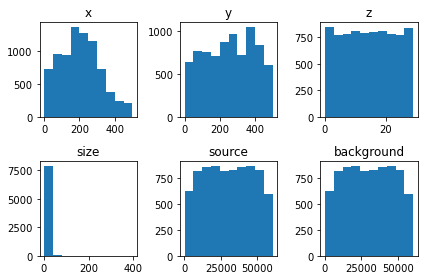

# Background shape size: 5, shape threshold size: 250 
Detected 487 total cells


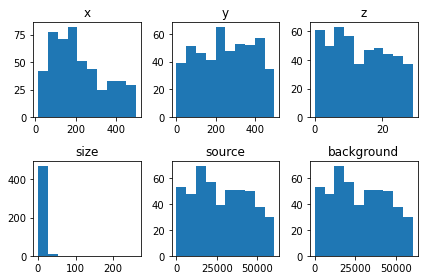

# Background shape size: 5, shape threshold size: 350 
Detected 148 total cells


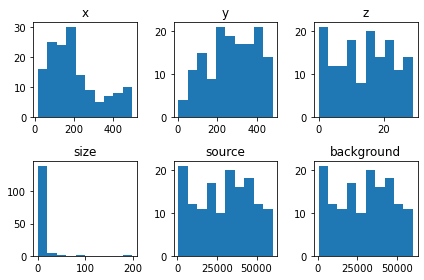

# Background shape size: 7, shape threshold size: 150 
Detected 10823 total cells


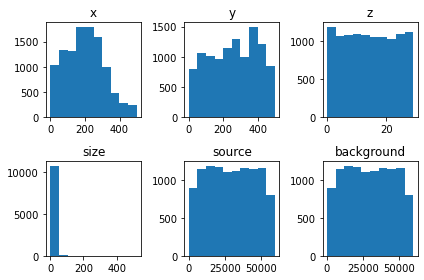

# Background shape size: 7, shape threshold size: 250 
Detected 611 total cells


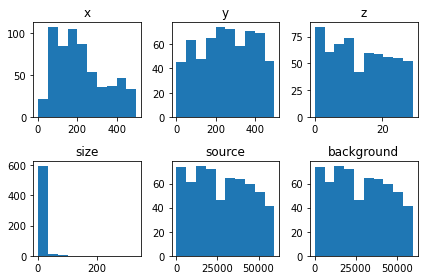

# Background shape size: 7, shape threshold size: 350 
Detected 202 total cells


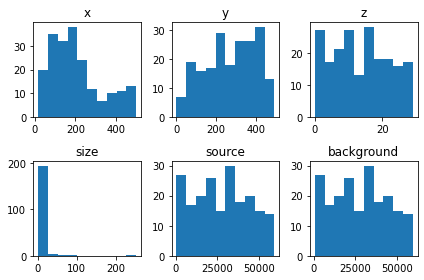

# Background shape size: 9, shape threshold size: 150 
Detected 12889 total cells


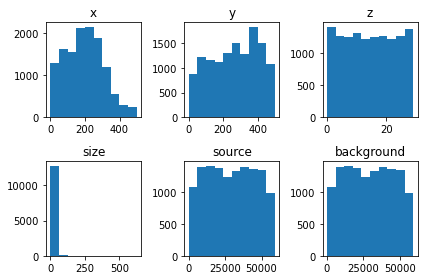

# Background shape size: 9, shape threshold size: 250 
Detected 696 total cells


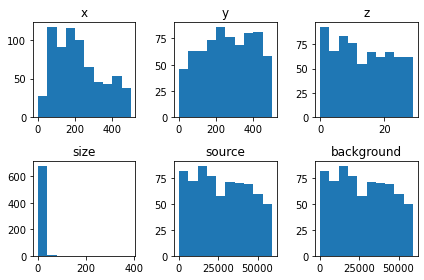

# Background shape size: 9, shape threshold size: 350 
Detected 226 total cells


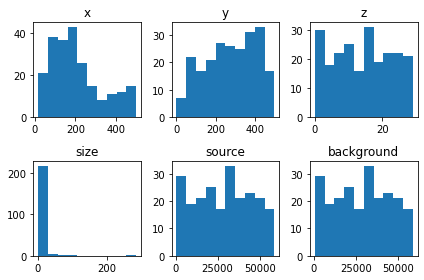

In [114]:
for background_size,shape_threshold_size in product(background_sizes,shape_threshold_sizes):
    postfix = f'raw_bck{background_size}_shpthresh{shape_threshold_size}'
    source = ws.source('cells', postfix=postfix)

    plt.figure(1); plt.clf();
    names = source.dtype.names;
    nx,ny = 2,3
    for i, name in enumerate(names):
        plt.subplot(nx, ny, i+1)
        plt.hist(source[name]);
        plt.title(name)
    plt.tight_layout();
    print(f"# Background shape size: {background_size}, shape threshold size: {shape_threshold_size} ")
    n_tot = len(source['x'])
    print(f"Detected {n_tot} total cells")
    plt.show()



# Background shape size: 5, shape threshold size: 150 
Detected 7961 total cells


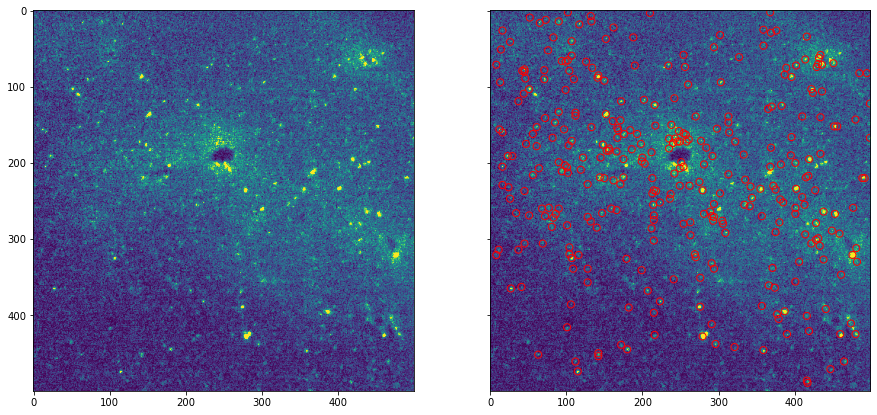

# Background shape size: 5, shape threshold size: 250 
Detected 487 total cells


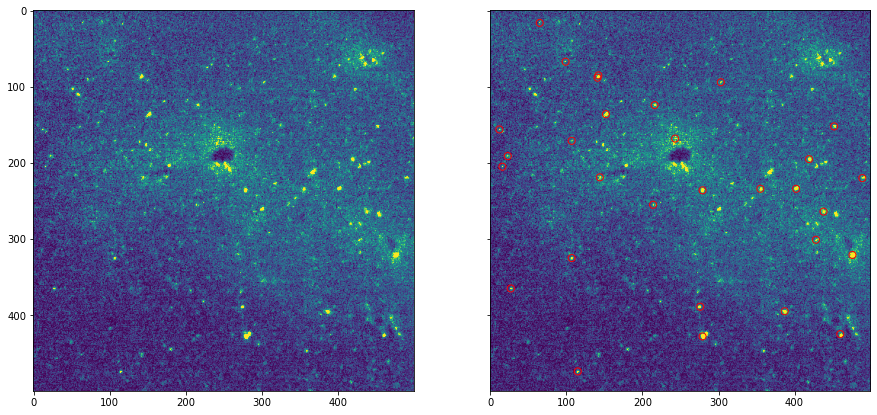

# Background shape size: 5, shape threshold size: 350 
Detected 148 total cells


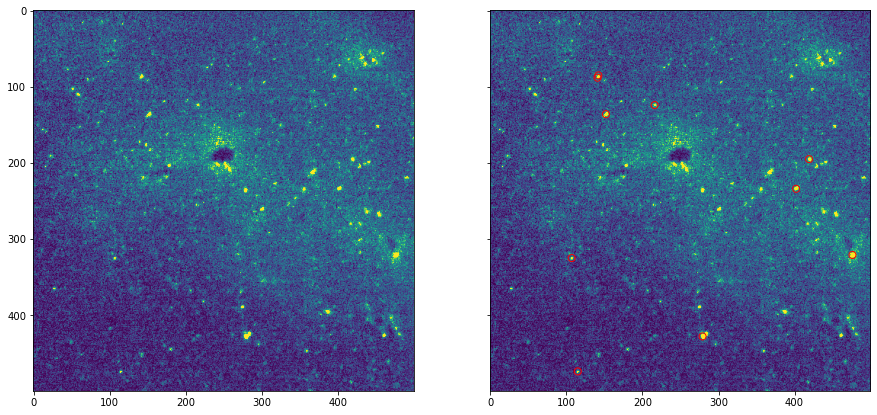

# Background shape size: 7, shape threshold size: 150 
Detected 10823 total cells


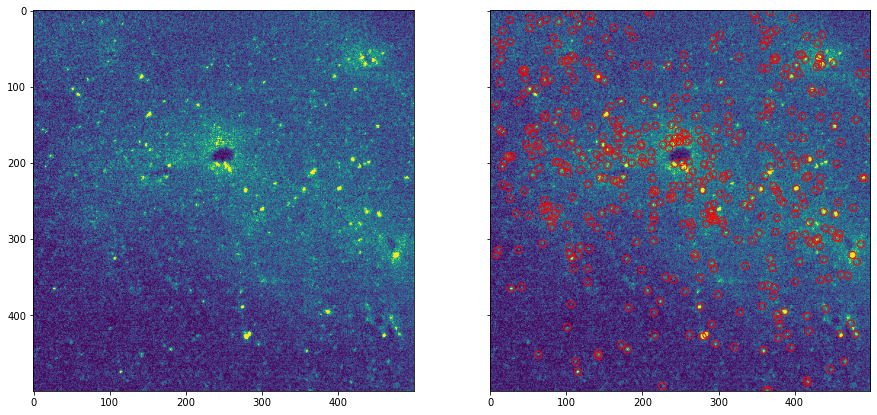

# Background shape size: 7, shape threshold size: 250 
Detected 611 total cells


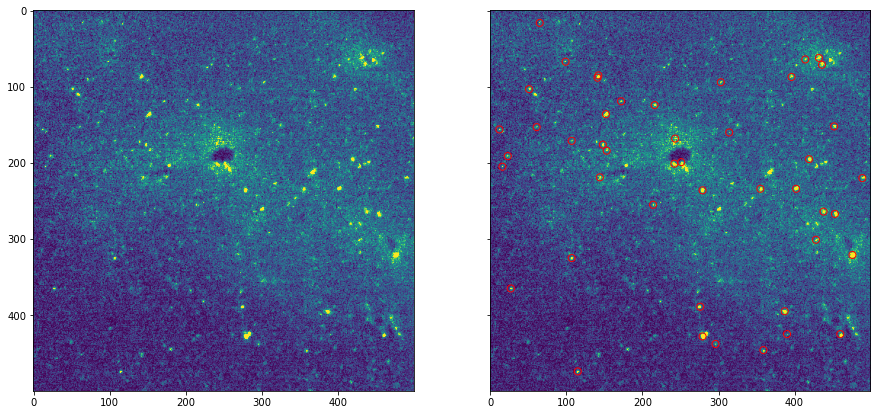

# Background shape size: 7, shape threshold size: 350 
Detected 202 total cells


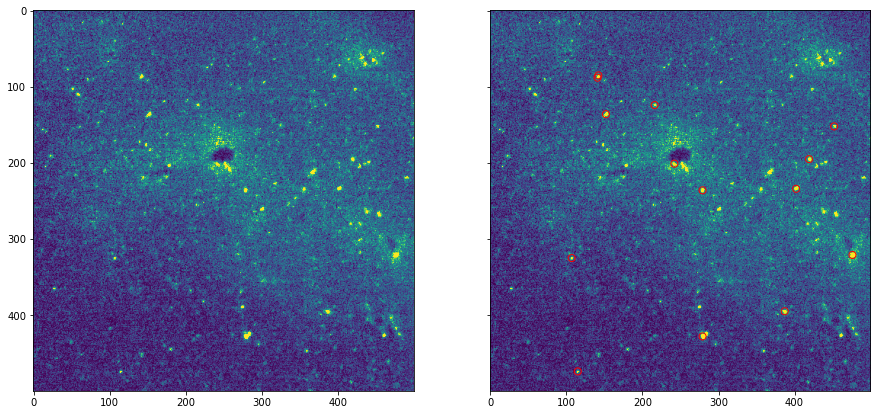

# Background shape size: 9, shape threshold size: 150 
Detected 12889 total cells


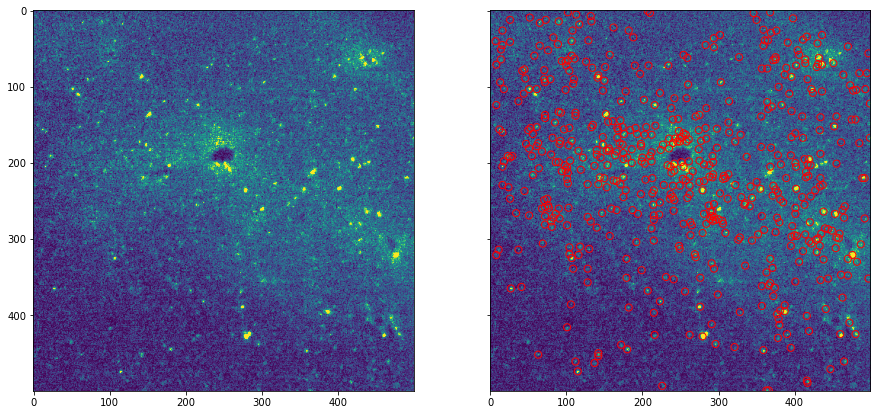

# Background shape size: 9, shape threshold size: 250 
Detected 696 total cells


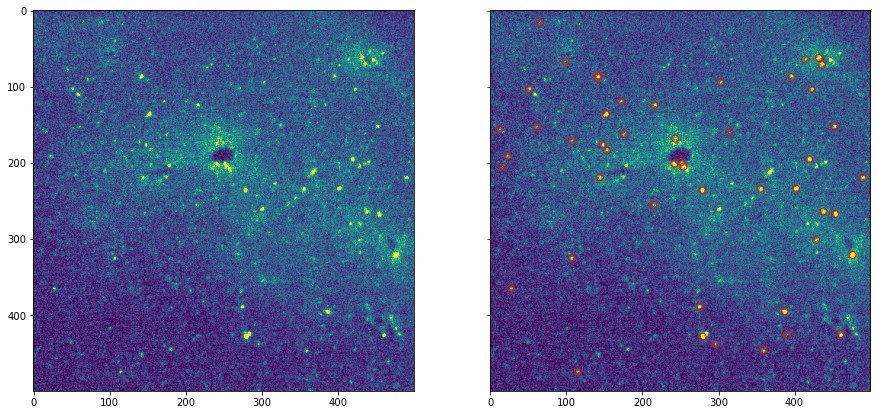

# Background shape size: 9, shape threshold size: 350 
Detected 226 total cells


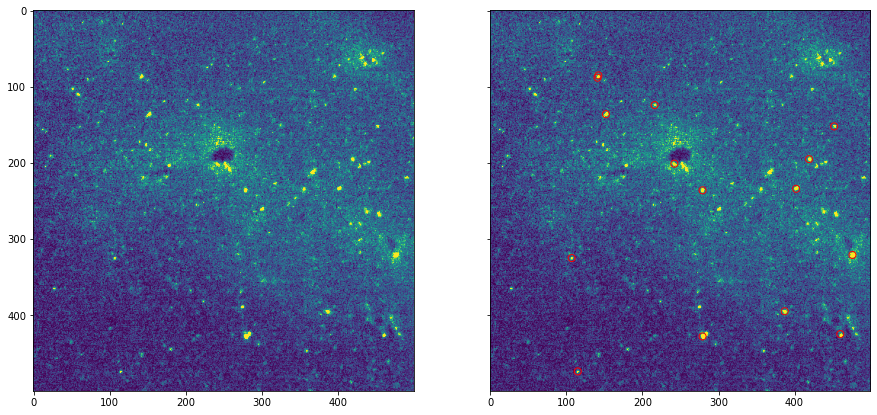

In [115]:
for background_size,shape_threshold_size in product(background_sizes,shape_threshold_sizes):
    postfix = f'raw_bck{background_size}_shpthresh{shape_threshold_size}'
    print(f"# Background shape size: {background_size}, shape threshold size: {shape_threshold_size} ")

    source = ws.source('cells', postfix=postfix)
    n_tot = len(source['x'])
    print(f"Detected {n_tot} total cells")
    coordinates = np.hstack([source[c][:,None] for c in 'xyz']);
    this_plane_coords = np.array([coord for coord in coordinates if coord[-1] ==0])
    xs = this_plane_coords[:,0]
    ys = this_plane_coords[:,1]
    fig,axes = plt.subplots(figsize=(15,8),nrows=1,ncols=2,sharex=True,sharey=True)
    ax_tissue = axes[0]
    ax_tissue.imshow(stitched_z_plane,vmin=0,vmax=200,cmap='viridis')
    ax_both=axes[1]
    ax_both.imshow(stitched_z_plane,vmin=0,vmax=200,cmap='viridis')
    ax_both.scatter(ys,xs,s=50,facecolors='none',edgecolors='r')
    plt.show()

Left is just the tissue, right is the image with cell centers overlaid. Note that this is only showing a single slice. There are 30 z slices in this subvolume, so may be worth looking at others.

The shape threshold size makes much more of a difference than the background shape size. 
As the shape threshold size increases, the number of cells detected decreases significantly. 

The background shape size is less important, but as it increases more cells are detected. 

Based on looking at the images, I would say the optimal parameters are a shape threshold size between 150 and 250 and a background shape size between 5 and 7. 
Based on this information let's run the cell detection again using parameters in this range.

In [116]:
background_size_opt = 5
shape_threshold_size_opt = 200
this_cell_parameter_dict = cell_detection_parameter.copy()
this_cell_parameter_dict['background_correction']['shape'] = (background_size_opt,background_size_opt)
this_cell_parameter_dict['shape_detection']['threshold'] = shape_threshold_size_opt
postfix = f'raw_bck{background_size_opt}_shpthresh{shape_threshold_size_opt}'
cells.detect_cells(ws.filename('stitched'), ws.filename('cells', postfix=postfix),
    cell_detection_parameter=this_cell_parameter_dict,
    processing_parameter=processing_parameter)

Processing 1 blocks with function 'detect_cells_block'.
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Background removal shape: (5, 5)
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Background removal form : Disk
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Background removal save : False
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Illumination correction: elapsed time: 0:00:00.098
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: DoG filter: shape : None
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: DoG filter: sigma : None
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: DoG filter: sigma2: None
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: DoG filter: elapsed time: 0:00:00.000
Block 0/

/usr/people/ahoag/.conda/envs/cm/lib/python3.7/site-packages/skimage/morphology/_deprecated.py:5: skimage_deprecation: Function ``watershed`` is deprecated and will be removed in version 0.19. Use ``skimage.segmentation.watershed`` instead.
  def watershed(image, markers=None, connectivity=1, offset=None, mask=None,


Shape detection: elapsed time: 0:00:00.400
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.808
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: method: max
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: shape : 3
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.492
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Cell detection: elapsed time: 0:00:02.075
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: elapsed time: 0:00:02.322
Processed 1 blocks with function 'detect_cells_block': elapsed time: 0:00:02.459


'/jukebox/wang/ahoag/test_clearmap2/output/cz15/zimmerman_01_smartspim/zimmerman_01-001/imaging_request_1/output/ch647_renamed/testchunk_cells_raw_bck5_shpthresh200.npy'

In [52]:
# Now visualize

Detected 1205 total cells


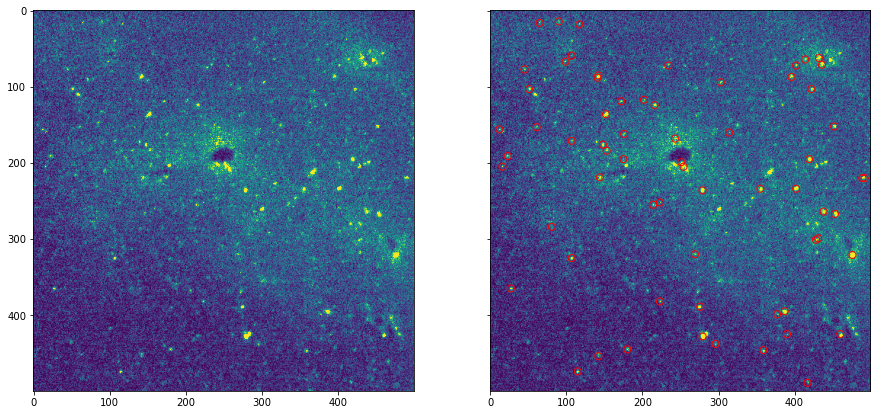

In [117]:
postfix = f'raw_bck{background_size_opt}_shpthresh{shape_threshold_size_opt}'
source = ws.source('cells', postfix=postfix)
n_tot = len(source['x'])
print(f"Detected {n_tot} total cells")
coordinates = np.hstack([source[c][:,None] for c in 'xyz']);
this_plane_coords = np.array([coord for coord in coordinates if coord[-1] ==0])
xs = this_plane_coords[:,0]
ys = this_plane_coords[:,1]
fig,axes = plt.subplots(figsize=(15,8),nrows=1,ncols=2,sharex=True,sharey=True)
ax_tissue = axes[0]
ax_tissue.imshow(stitched_z_plane,vmin=0,vmax=200,cmap='viridis')
ax_both=axes[1]
ax_both.imshow(stitched_z_plane,vmin=0,vmax=200,cmap='viridis')
ax_both.scatter(ys,xs,s=50,facecolors='none',edgecolors='r')


Z=0 plane


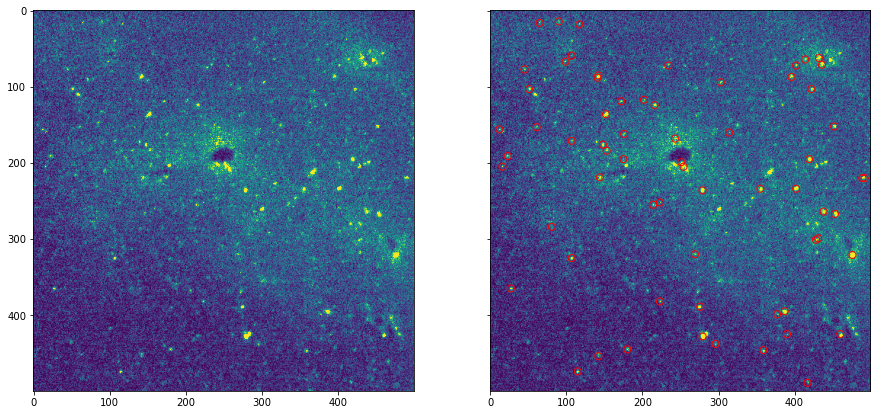

Z=5 plane


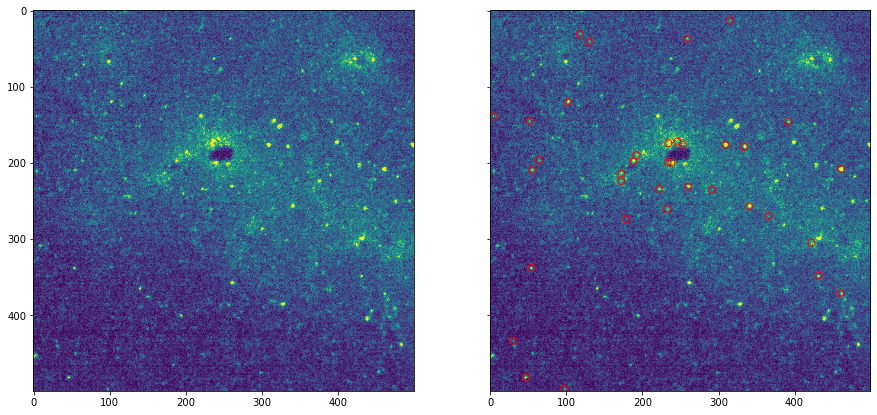

Z=10 plane


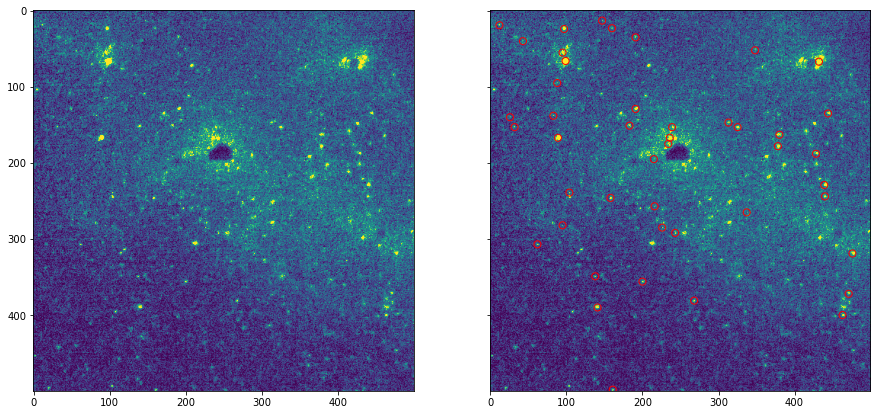

Z=15 plane


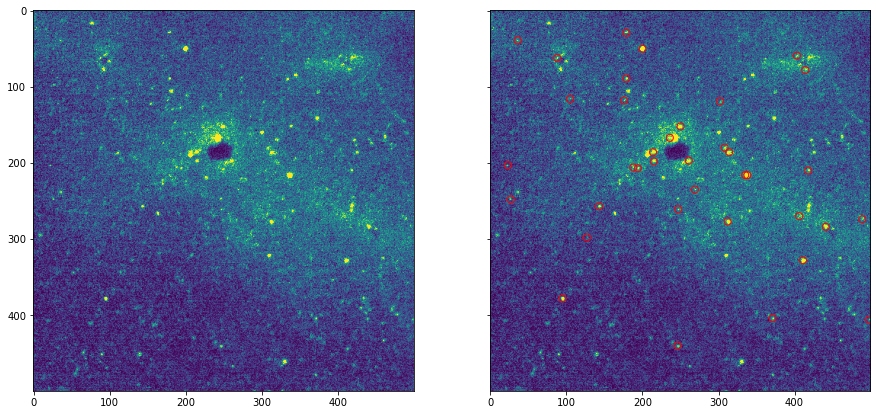

Z=20 plane


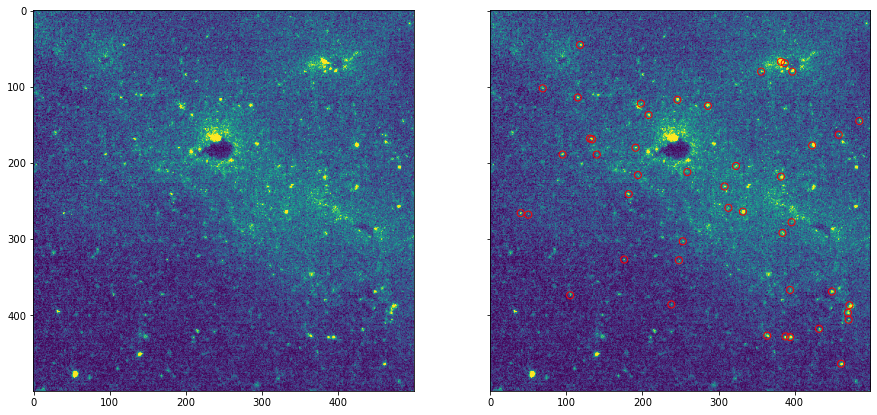

Z=25 plane


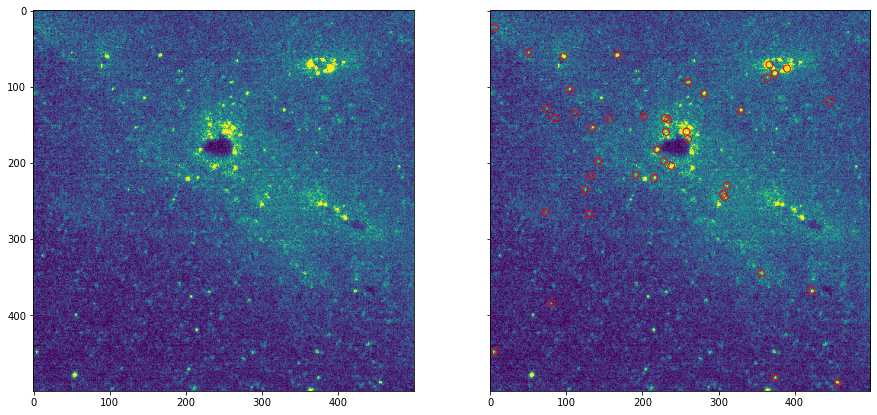

In [118]:
# Now let's look at every 5th plane
postfix = f'raw_bck{background_size_opt}_shpthresh{shape_threshold_size_opt}'
source = ws.source('cells', postfix=postfix)
coordinates = np.hstack([source[c][:,None] for c in 'xyz']);
for z in range(0,30,5):
    print(f"Z={z} plane")
    stitched_z_plane = ws.source('stitched')[:,:,z]
    this_plane_coords = np.array([coord for coord in coordinates if coord[-1] == z])
    xs = this_plane_coords[:,0]
    ys = this_plane_coords[:,1]
    fig,axes = plt.subplots(figsize=(15,8),nrows=1,ncols=2,sharex=True,sharey=True)
    ax_tissue = axes[0]
    ax_tissue.imshow(stitched_z_plane,vmin=0,vmax=200,cmap='viridis')
    ax_both=axes[1]
    ax_both.imshow(stitched_z_plane,vmin=0,vmax=200,cmap='viridis')
    ax_both.scatter(ys,xs,s=50,facecolors='none',edgecolors='r')
    plt.show()

# Use these cell detection parameters on a new subvolume of the brain
This is to make sure these cell detection parameters are generally appropriate throughout the brain, not just in this small subchunk we happened to choose. We want to do this before we run the cell detection on the entire brain using these parameters

In [119]:
# First let's find a section of the brain with tissue in it that is the same shape as our original test chunk

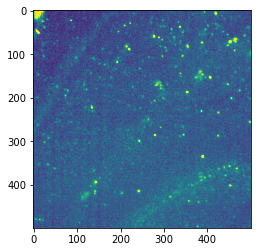

In [120]:
ws.debug=False
ws.source('raw')
fig=plt.figure()
ax=fig.add_subplot()
z_plane = ws.source('raw')[1500:2000,3200:3700,1050]
ax.imshow(z_plane,vmin=0,vmax=200)

In [9]:
ws.debug = 'validatechunk' 
slicing = (slice(1500,2000),slice(3200,3700),slice(1020,1050))
ws.create_debug('stitched', slicing=slicing) # creates a file called validatechunk_stitched.npy

'/jukebox/wang/ahoag/test_clearmap2/output/cz15/zimmerman_01_smartspim/zimmerman_01-001/imaging_request_1/output/ch647_renamed/validatechunk_stitched.npy'

In [10]:
ws.filename('stitched')

'/jukebox/wang/ahoag/test_clearmap2/output/cz15/zimmerman_01_smartspim/zimmerman_01-001/imaging_request_1/output/ch647_renamed/validatechunk_stitched.npy'

In [13]:
background_size_opt = 7
shape_threshold_size_opt = 150
cell_detection_parameter = cells.default_cell_detection_parameter.copy()
cell_detection_parameter['illumination'] = None
cell_detection_parameter['intensity_detection']['measure'] = ['source','background']
this_cell_parameter_dict = cell_detection_parameter.copy()
this_cell_parameter_dict['maxima_detection']['save'] = False
this_cell_parameter_dict['background_correction']['shape'] = (background_size_opt,background_size_opt)
this_cell_parameter_dict['shape_detection']['threshold'] = shape_threshold_size_opt
processing_parameter = cells.default_cell_detection_processing_parameter.copy()
processing_parameter.update(
    processes = 'serial',
    size_max = 100, #35,
    size_min = 30, #30,
    overlap  = 15, #10,
    verbose = True
    )
postfix = f'raw_bck{background_size_opt}_shpthresh{shape_threshold_size_opt}'
#     print(ws.filename('cells', postfix=postfix))
cells.detect_cells(ws.filename('stitched'), ws.filename('cells', postfix=postfix),
    cell_detection_parameter=this_cell_parameter_dict,
    processing_parameter=processing_parameter)

Processing 1 blocks with function 'detect_cells_block'.
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Background removal shape: (7, 7)
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Background removal form : Disk
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Background removal save : False
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Illumination correction: elapsed time: 0:00:00.130
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: DoG filter: shape : None
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: DoG filter: sigma : None
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: DoG filter: sigma2: None
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: DoG filter: elapsed time: 0:00:00.000
Block 0/

/usr/people/ahoag/.conda/envs/cm/lib/python3.7/site-packages/skimage/morphology/_deprecated.py:5: skimage_deprecation: Function ``watershed`` is deprecated and will be removed in version 0.19. Use ``skimage.segmentation.watershed`` instead.
  def watershed(image, markers=None, connectivity=1, offset=None, mask=None,


Shape detection: elapsed time: 0:00:00.480
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.723
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: method: max
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: shape : 3
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.634
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Cell detection: elapsed time: 0:00:02.089
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: elapsed time: 0:00:02.218
Processed 1 blocks with function 'detect_cells_block': elapsed time: 0:00:02.278


'/jukebox/wang/ahoag/test_clearmap2/output/cz15/zimmerman_01_smartspim/zimmerman_01-001/imaging_request_1/output/ch647_renamed/validatechunk_cells_raw_bck7_shpthresh150.npy'

Z=0 plane


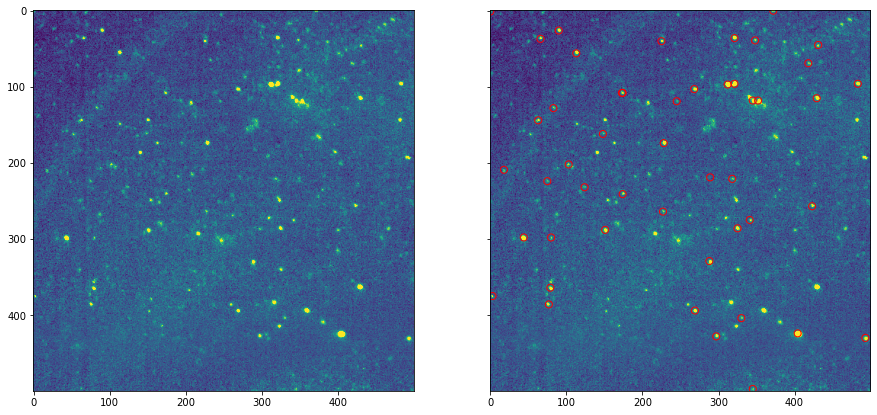

Z=5 plane


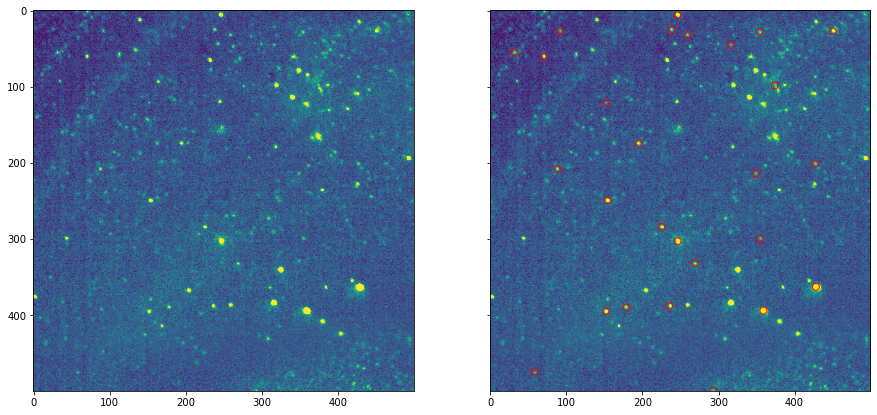

Z=10 plane


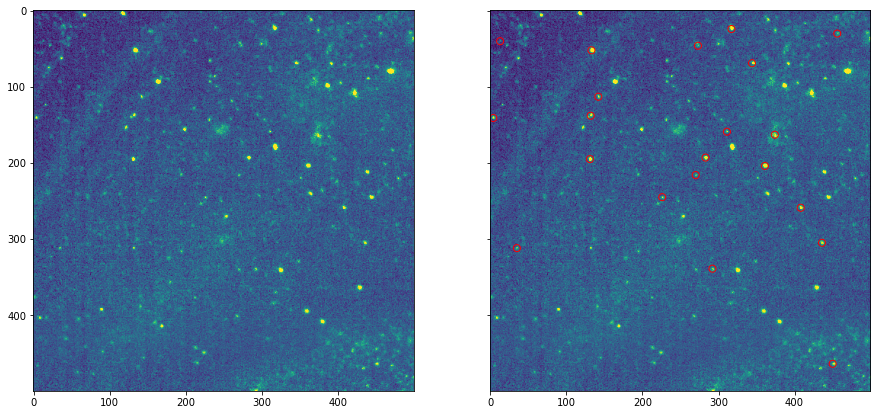

Z=15 plane


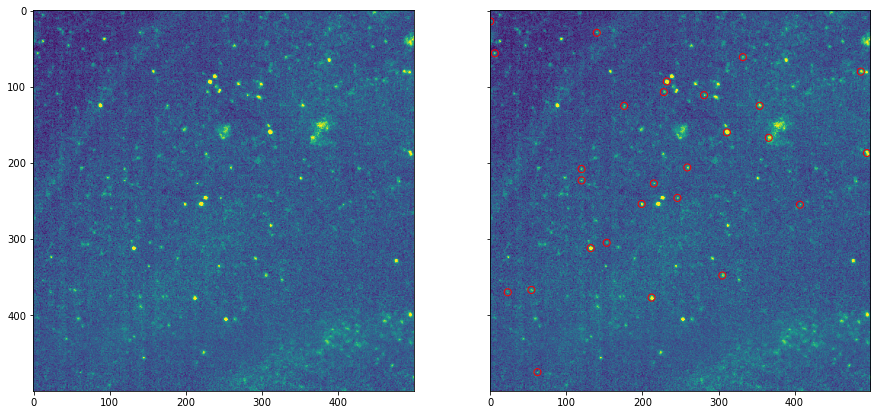

Z=20 plane


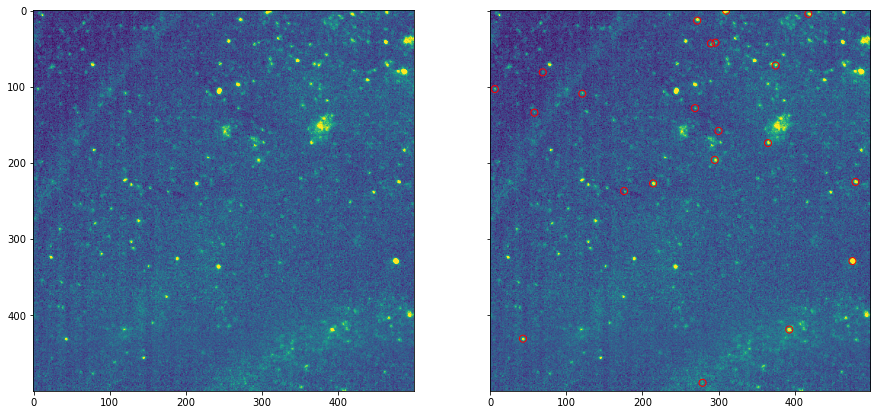

Z=25 plane


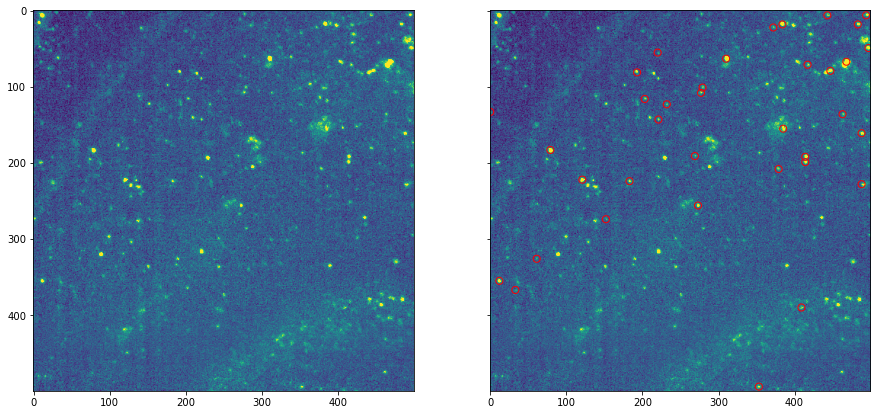

In [14]:
# Now let's look at every 5th plane for this new validation chunk as we did for the test chunk
postfix = f'raw_bck{background_size_opt}_shpthresh{shape_threshold_size_opt}'

source = ws.source('cells', postfix=postfix)
coordinates = np.hstack([source[c][:,None] for c in 'xyz']);
for z in range(0,30,5):
    print(f"Z={z} plane")
    stitched_z_plane = ws.source('stitched')[:,:,z]
    this_plane_coords = np.array([coord for coord in coordinates if coord[-1] == z])
    xs = this_plane_coords[:,0]
    ys = this_plane_coords[:,1]
    fig,axes = plt.subplots(figsize=(15,8),nrows=1,ncols=2,sharex=True,sharey=True)
    ax_tissue = axes[0]
    ax_tissue.imshow(stitched_z_plane,vmin=0,vmax=200,cmap='viridis')
    ax_both=axes[1]
    ax_both.imshow(stitched_z_plane,vmin=0,vmax=200,cmap='viridis')
    ax_both.scatter(ys,xs,s=50,facecolors='none',edgecolors='r')
    plt.show()

In [125]:
# seems to miss some small cells. Maybe we need to turn the shape size threshold down to 150
background_size_opt = 5
shape_threshold_size_opt = 175
this_cell_parameter_dict = cell_detection_parameter.copy()
this_cell_parameter_dict['maxima_detection']['save'] = False
this_cell_parameter_dict['background_correction']['shape'] = (background_size_opt,background_size_opt)
this_cell_parameter_dict['shape_detection']['threshold'] = shape_threshold_size_opt
postfix = f'raw_bck{background_size_opt}_shpthresh{shape_threshold_size_opt}'
#     print(ws.filename('cells', postfix=postfix))
cells.detect_cells(ws.filename('stitched'), ws.filename('cells', postfix=postfix),
    cell_detection_parameter=this_cell_parameter_dict,
    processing_parameter=processing_parameter)

Processing 1 blocks with function 'detect_cells_block'.
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Background removal shape: (5, 5)
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Background removal form : Disk
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Background removal save : False
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Illumination correction: elapsed time: 0:00:00.138
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: DoG filter: shape : None
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: DoG filter: sigma : None
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: DoG filter: sigma2: None
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: DoG filter: elapsed time: 0:00:00.000
Block 0/

/usr/people/ahoag/.conda/envs/cm/lib/python3.7/site-packages/skimage/morphology/_deprecated.py:5: skimage_deprecation: Function ``watershed`` is deprecated and will be removed in version 0.19. Use ``skimage.segmentation.watershed`` instead.
  def watershed(image, markers=None, connectivity=1, offset=None, mask=None,


Shape detection: elapsed time: 0:00:00.485
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.669
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: method: max
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: shape : 3
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.525
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Cell detection: elapsed time: 0:00:01.933
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: elapsed time: 0:00:02.197
Processed 1 blocks with function 'detect_cells_block': elapsed time: 0:00:02.349


'/jukebox/wang/ahoag/test_clearmap2/output/cz15/zimmerman_01_smartspim/zimmerman_01-001/imaging_request_1/output/ch647_renamed/validatechunk_cells_raw_bck5_shpthresh150.npy'

Z=0 plane


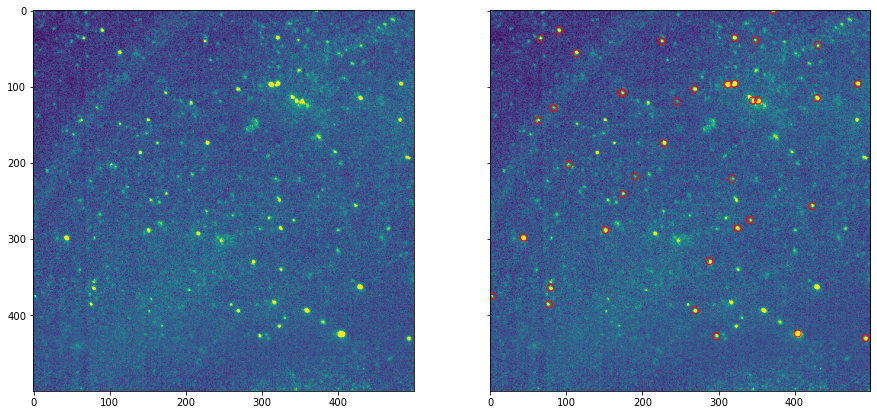

Z=5 plane


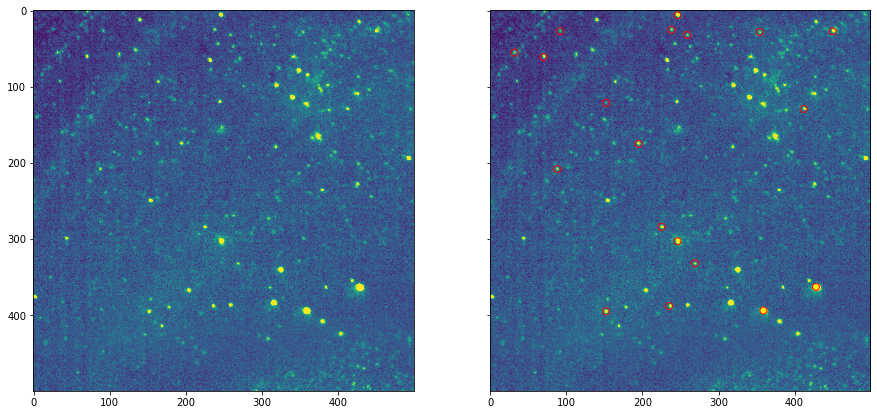

Z=10 plane


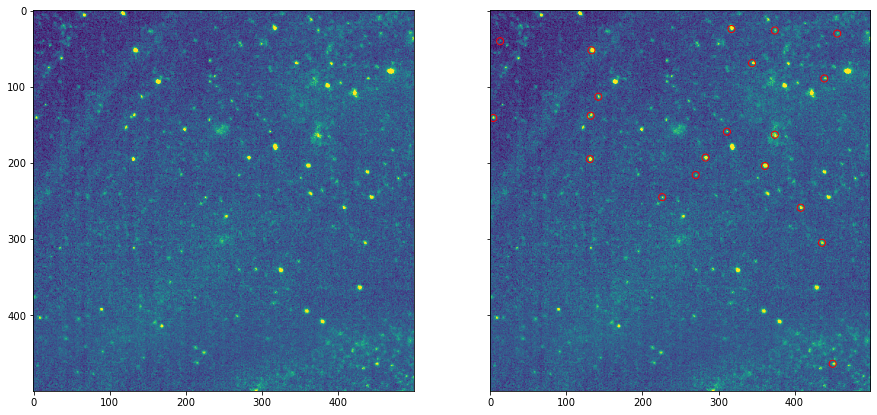

Z=15 plane


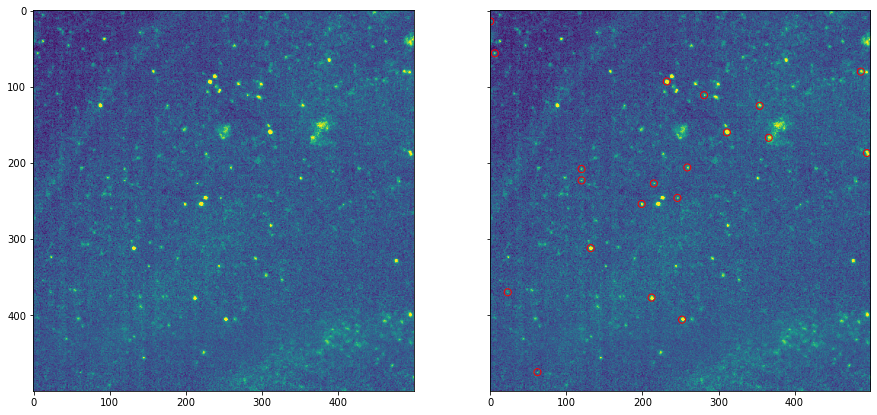

Z=20 plane


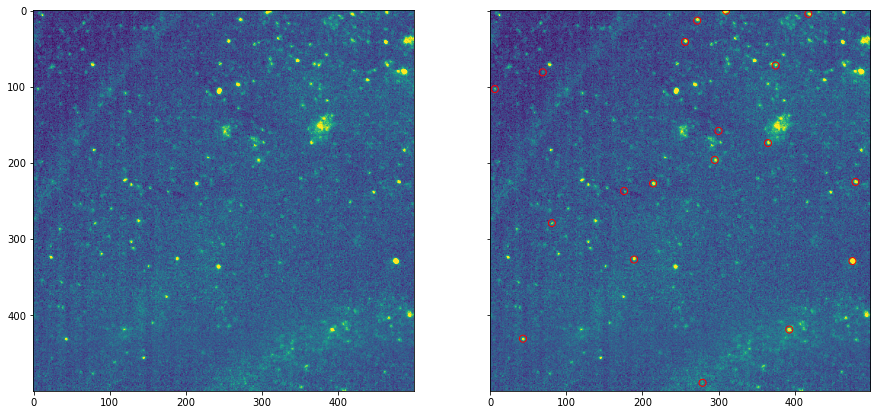

Z=25 plane


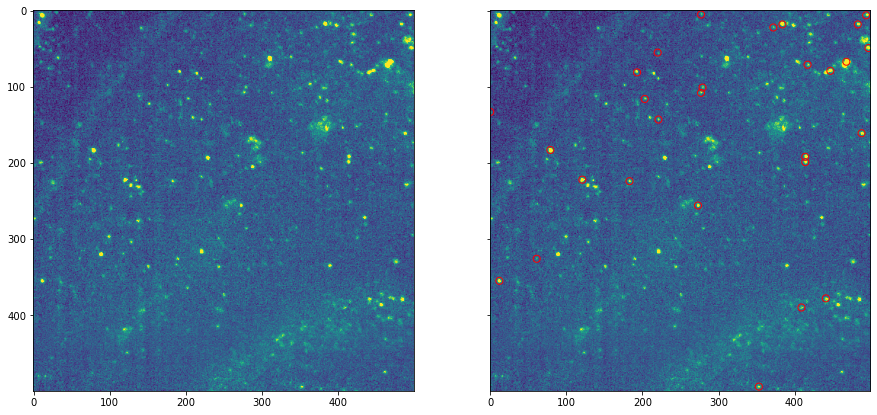

In [126]:
# Now let's look at every 5th plane for this new validation chunk as we did for the test chunk
postfix = f'raw_bck{background_size_opt}_shpthresh{shape_threshold_size_opt}'

source = ws.source('cells', postfix=postfix)
coordinates = np.hstack([source[c][:,None] for c in 'xyz']);
for z in range(0,30,5):
    print(f"Z={z} plane")
    stitched_z_plane = ws.source('stitched')[:,:,z]
    this_plane_coords = np.array([coord for coord in coordinates if coord[-1] == z])
    xs = this_plane_coords[:,0]
    ys = this_plane_coords[:,1]
    fig,axes = plt.subplots(figsize=(15,8),nrows=1,ncols=2,sharex=True,sharey=True)
    ax_tissue = axes[0]
    ax_tissue.imshow(stitched_z_plane,vmin=0,vmax=200,cmap='viridis')
    ax_both=axes[1]
    ax_both.imshow(stitched_z_plane,vmin=0,vmax=200,cmap='viridis')
    ax_both.scatter(ys,xs,s=50,facecolors='none',edgecolors='r')
    plt.show()

In [ ]:
# OK so 200 looks good for the test chunk but 150 looks better for the validation chunk. Maybe we need to try 
# a different shape radius

In [132]:
# seems to miss some small cells. Maybe we need to turn the shape size threshold down to 175
background_size_opt = 7
shape_threshold_size_opt = 150
this_cell_parameter_dict = cell_detection_parameter.copy()
this_cell_parameter_dict['maxima_detection']['save'] = False
this_cell_parameter_dict['background_correction']['shape'] = (background_size_opt,background_size_opt)
this_cell_parameter_dict['shape_detection']['threshold'] = shape_threshold_size_opt
postfix = f'raw_bck{background_size_opt}_shpthresh{shape_threshold_size_opt}'
#     print(ws.filename('cells', postfix=postfix))
cells.detect_cells(ws.filename('stitched'), ws.filename('cells', postfix=postfix),
    cell_detection_parameter=this_cell_parameter_dict,
    processing_parameter=processing_parameter)

Processing 1 blocks with function 'detect_cells_block'.
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Background removal shape: (7, 7)
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Background removal form : Disk
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Background removal save : False
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Illumination correction: elapsed time: 0:00:00.097
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: DoG filter: shape : None
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: DoG filter: sigma : None
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: DoG filter: sigma2: None
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: DoG filter: elapsed time: 0:00:00.000
Block 0/

/usr/people/ahoag/.conda/envs/cm/lib/python3.7/site-packages/skimage/morphology/_deprecated.py:5: skimage_deprecation: Function ``watershed`` is deprecated and will be removed in version 0.19. Use ``skimage.segmentation.watershed`` instead.
  def watershed(image, markers=None, connectivity=1, offset=None, mask=None,


Shape detection: elapsed time: 0:00:00.392
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.550
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: method: max
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: shape : 3
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.477
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Cell detection: elapsed time: 0:00:01.686
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: elapsed time: 0:00:01.878
Processed 1 blocks with function 'detect_cells_block': elapsed time: 0:00:02.013


'/jukebox/wang/ahoag/test_clearmap2/output/cz15/zimmerman_01_smartspim/zimmerman_01-001/imaging_request_1/output/ch647_renamed/validatechunk_cells_raw_bck7_shpthresh150.npy'

Z=0 plane


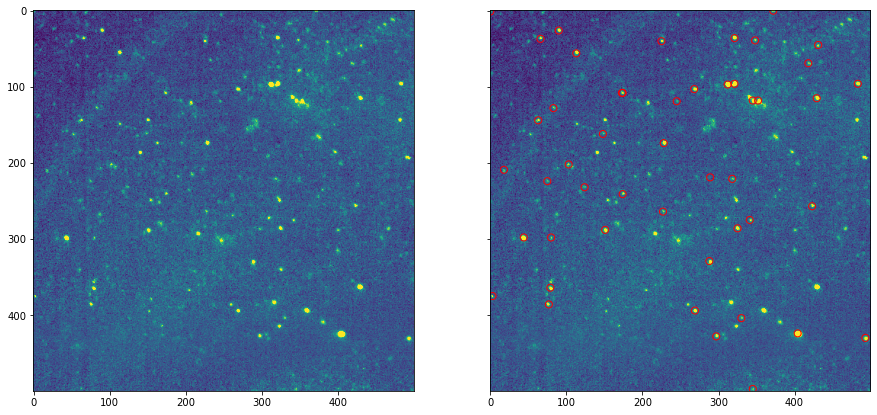

Z=5 plane


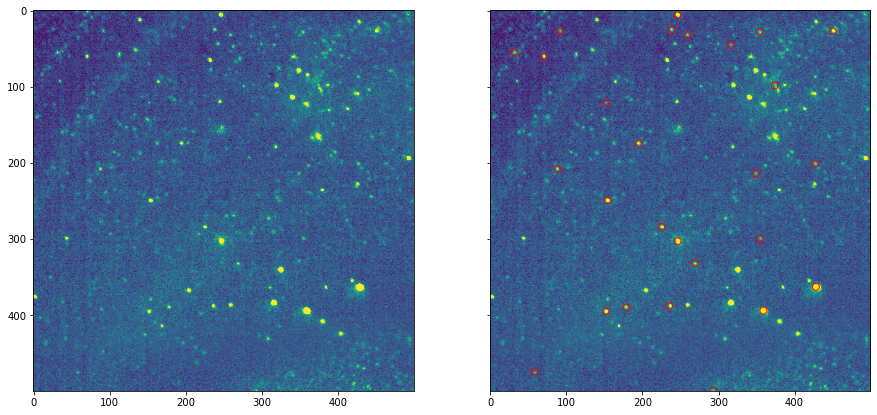

Z=10 plane


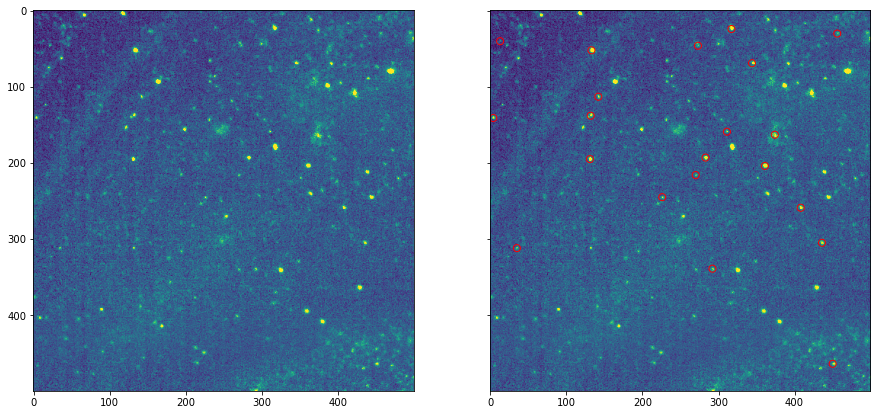

Z=15 plane


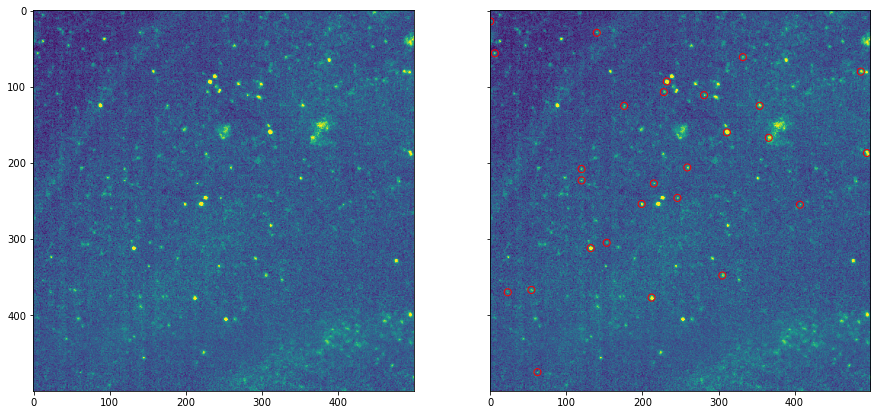

Z=20 plane


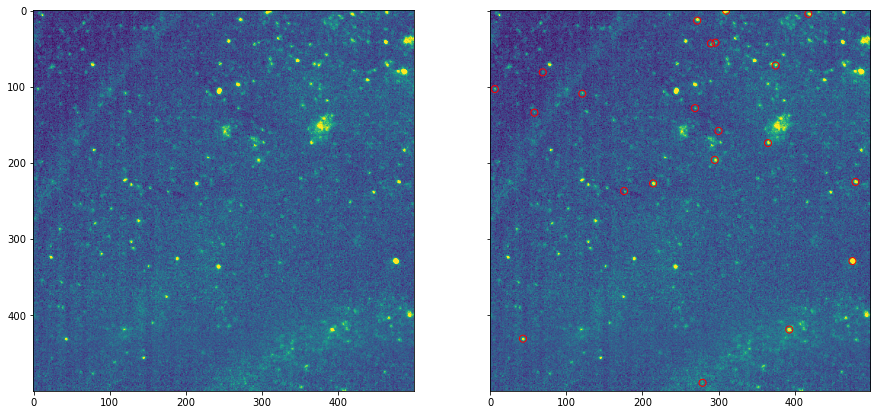

Z=25 plane


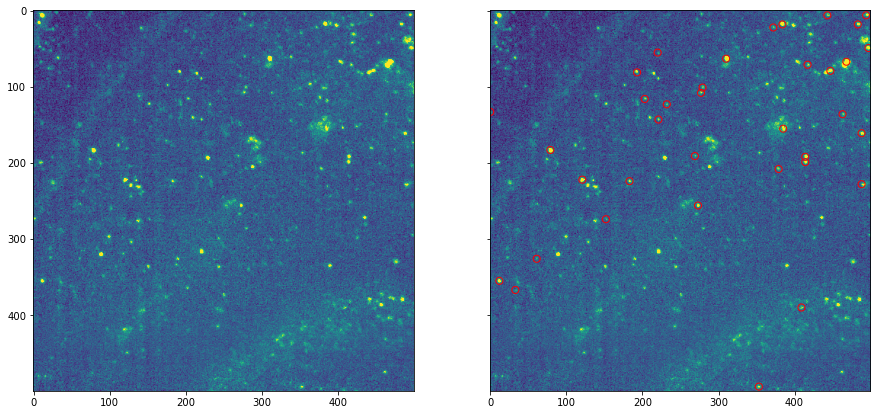

In [133]:
# Now let's look at every 5th plane for this new validation chunk as we did for the test chunk
postfix = f'raw_bck{background_size_opt}_shpthresh{shape_threshold_size_opt}'
source = ws.source('cells', postfix=postfix)
coordinates = np.hstack([source[c][:,None] for c in 'xyz']);
for z in range(0,30,5):
    print(f"Z={z} plane")
    stitched_z_plane = ws.source('stitched')[:,:,z]
    
    this_plane_coords = np.array([coord for coord in coordinates if coord[-1] == z])
    xs = this_plane_coords[:,0]
    ys = this_plane_coords[:,1]
    fig,axes = plt.subplots(figsize=(15,8),nrows=1,ncols=2,sharex=True,sharey=True)
    ax_tissue = axes[0]
    ax_tissue.imshow(stitched_z_plane,vmin=0,vmax=200,cmap='viridis')
    ax_both=axes[1]
    ax_both.imshow(stitched_z_plane,vmin=0,vmax=200,cmap='viridis')
    ax_both.scatter(ys,xs,s=50,facecolors='none',edgecolors='r')
    plt.show()

In [134]:
# OK, so background of 7, shape threshold size of 150 seems to be a good compromise between test and validation
# Now let's take a final section of the brain as the final test set to make sure it generalizes

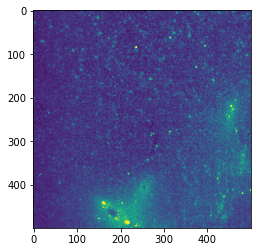

In [137]:
ws.debug=False
ws.source('raw')
fig=plt.figure()
ax=fig.add_subplot()
z_plane = ws.source('raw')[1500:2000,1500:2000,1300]
ax.imshow(z_plane,vmin=0,vmax=200)

In [140]:
ws.debug = 'finaltest' 
slicing = (slice(1500,2000),slice(1500,2000),slice(1250,1280))
ws.create_debug('stitched', slicing=slicing) # creates a file called finaltest_stitched.npy

'/jukebox/wang/ahoag/test_clearmap2/output/cz15/zimmerman_01_smartspim/zimmerman_01-001/imaging_request_1/output/ch647_renamed/finaltest_stitched.npy'

In [141]:
ws.source('stitched').shape

(500, 500, 30)

In [142]:
# Run cell detection on final test set
background_size_opt = 7
shape_threshold_size_opt = 150
this_cell_parameter_dict = cell_detection_parameter.copy()
this_cell_parameter_dict['maxima_detection']['save'] = False
this_cell_parameter_dict['background_correction']['shape'] = (background_size_opt,background_size_opt)
this_cell_parameter_dict['shape_detection']['threshold'] = shape_threshold_size_opt
postfix = f'raw_bck{background_size_opt}_shpthresh{shape_threshold_size_opt}'
#     print(ws.filename('cells', postfix=postfix))
cells.detect_cells(ws.filename('stitched'), ws.filename('cells', postfix=postfix),
    cell_detection_parameter=this_cell_parameter_dict,
    processing_parameter=processing_parameter)

Processing 1 blocks with function 'detect_cells_block'.
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Background removal shape: (7, 7)
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Background removal form : Disk
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Background removal save : False
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Illumination correction: elapsed time: 0:00:00.145
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: DoG filter: shape : None
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: DoG filter: sigma : None
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: DoG filter: sigma2: None
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: DoG filter: elapsed time: 0:00:00.000
Block 0/

/usr/people/ahoag/.conda/envs/cm/lib/python3.7/site-packages/skimage/morphology/_deprecated.py:5: skimage_deprecation: Function ``watershed`` is deprecated and will be removed in version 0.19. Use ``skimage.segmentation.watershed`` instead.
  def watershed(image, markers=None, connectivity=1, offset=None, mask=None,


Shape detection: elapsed time: 0:00:00.479
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.687
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: method: max
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Intensity detection: shape : 3
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Shape detection: elapsed time: 0:00:00.564
Block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: Cell detection: elapsed time: 0:00:01.958
Processing block 0/1<(0, 0, 0)/(1, 1, 1)> (500, 500, 30)@(500, 500, 30)[(:,:,0:30)]: elapsed time: 0:00:02.227
Processed 1 blocks with function 'detect_cells_block': elapsed time: 0:00:02.394


'/jukebox/wang/ahoag/test_clearmap2/output/cz15/zimmerman_01_smartspim/zimmerman_01-001/imaging_request_1/output/ch647_renamed/finaltest_cells_raw_bck7_shpthresh150.npy'

Z=0 plane


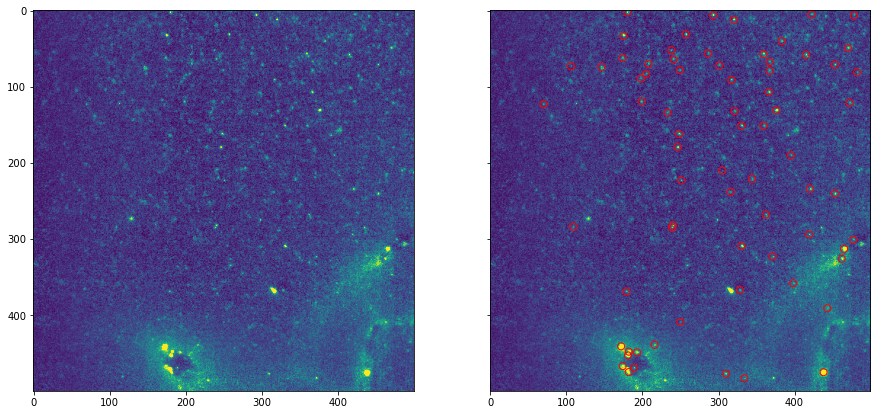

Z=5 plane


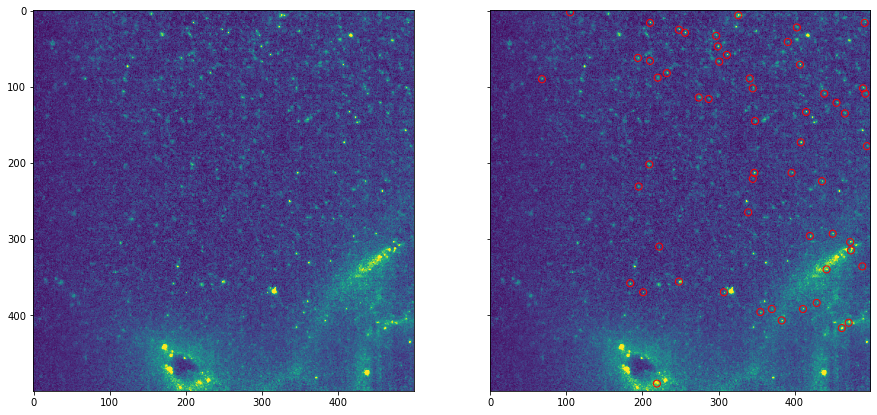

Z=10 plane


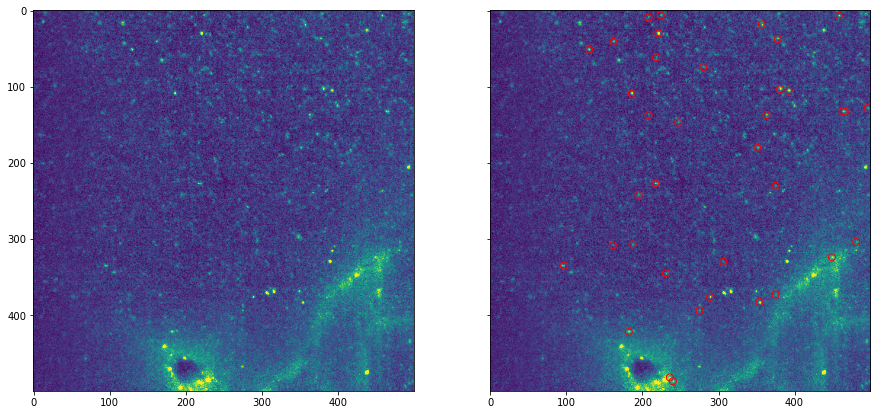

Z=15 plane


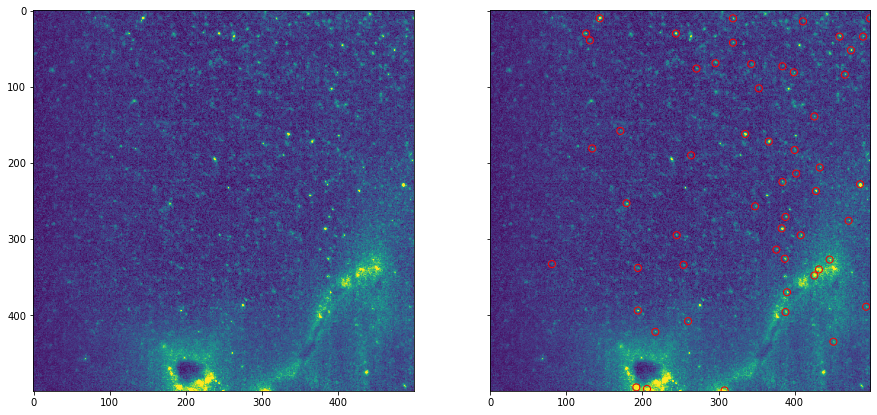

Z=20 plane


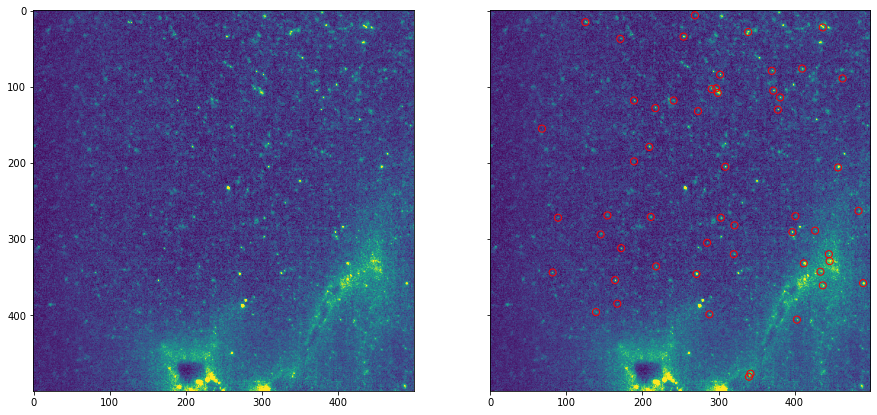

Z=25 plane


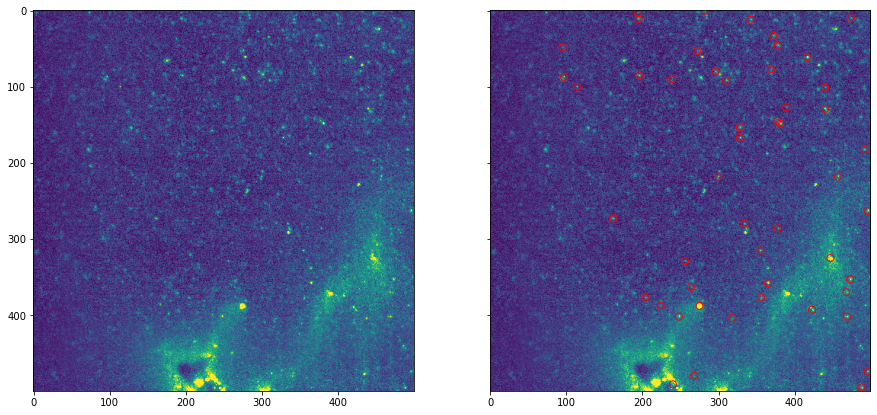

In [143]:
# Now let's look at every 5th plane for this new validation chunk as we did for the test chunk
postfix = f'raw_bck{background_size_opt}_shpthresh{shape_threshold_size_opt}'
source = ws.source('cells', postfix=postfix)
coordinates = np.hstack([source[c][:,None] for c in 'xyz']);
for z in range(0,30,5):
    print(f"Z={z} plane")
    stitched_z_plane = ws.source('stitched')[:,:,z]
    
    this_plane_coords = np.array([coord for coord in coordinates if coord[-1] == z])
    xs = this_plane_coords[:,0]
    ys = this_plane_coords[:,1]
    fig,axes = plt.subplots(figsize=(15,8),nrows=1,ncols=2,sharex=True,sharey=True)
    ax_tissue = axes[0]
    ax_tissue.imshow(stitched_z_plane,vmin=0,vmax=200,cmap='viridis')
    ax_both=axes[1]
    ax_both.imshow(stitched_z_plane,vmin=0,vmax=200,cmap='viridis')
    ax_both.scatter(ys,xs,s=50,facecolors='none',edgecolors='r')
    plt.show()

In [ ]:
# Looks pretty good! Let's use these parameters to run on the entire brain.

In [5]:
ws.debug = 'testchunk-script' 


Z=0 plane


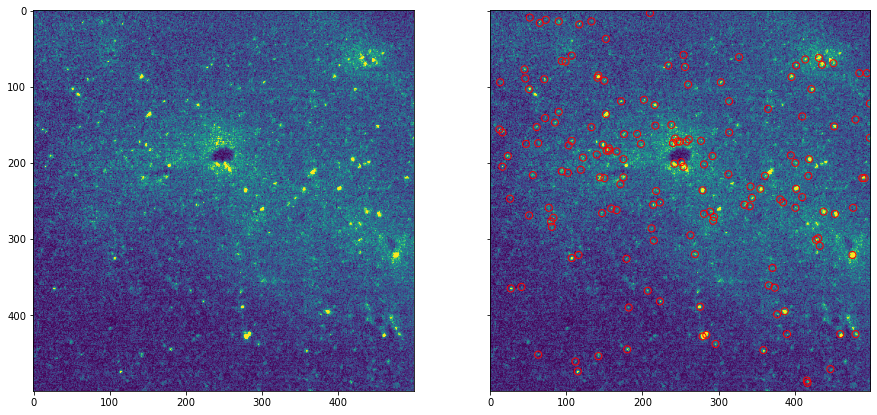

Z=5 plane


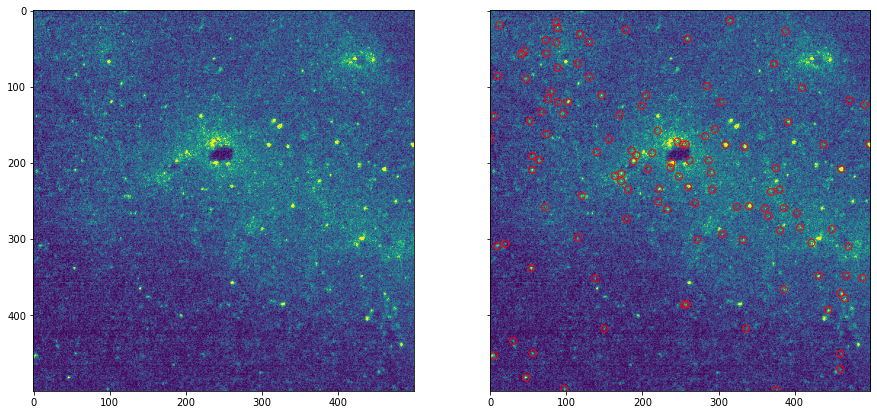

Z=10 plane


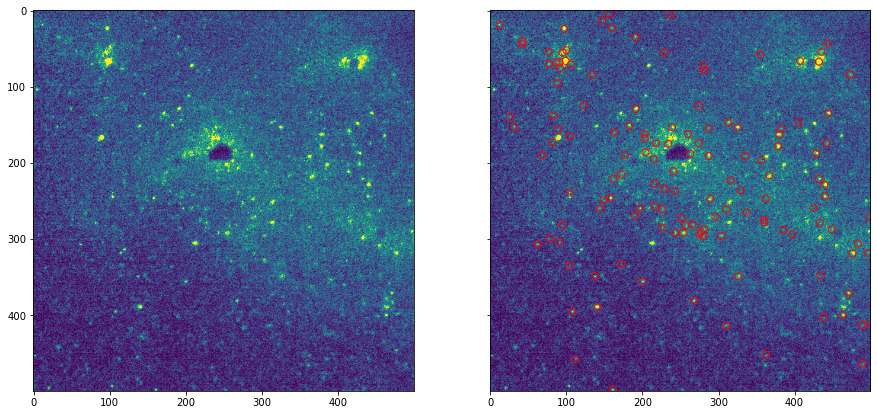

Z=15 plane


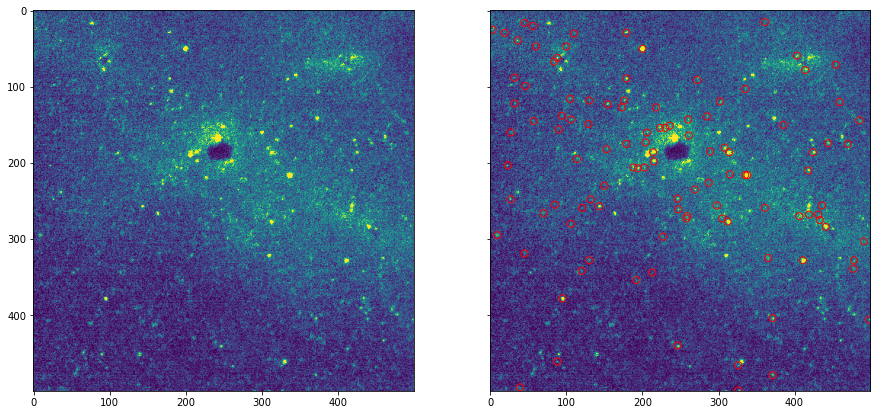

Z=20 plane


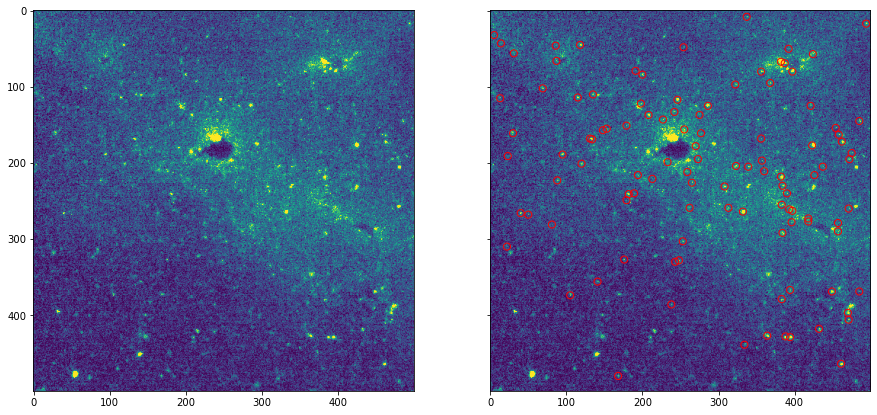

Z=25 plane


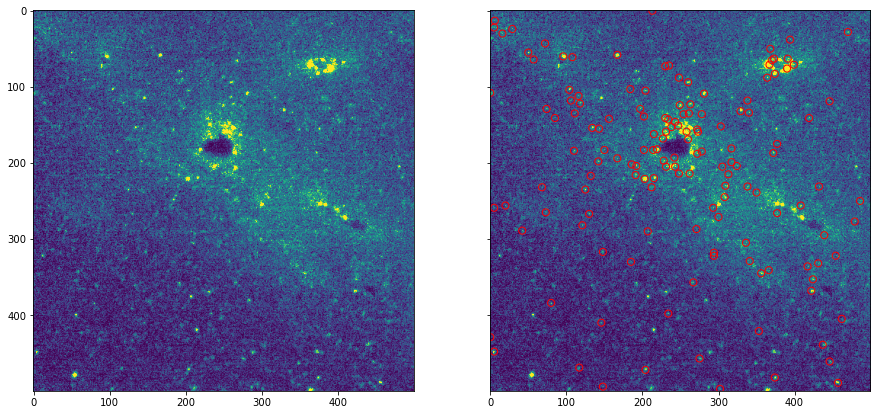

In [7]:
source = ws.source('cells', postfix='raw')
coordinates = np.hstack([source[c][:,None] for c in 'xyz']);
for z in range(0,30,5):
    print(f"Z={z} plane")
    stitched_z_plane = ws.source('stitched')[:,:,z]
    
    this_plane_coords = np.array([coord for coord in coordinates if coord[-1] == z])
    xs = this_plane_coords[:,0]
    ys = this_plane_coords[:,1]
    fig,axes = plt.subplots(figsize=(15,8),nrows=1,ncols=2,sharex=True,sharey=True)
    ax_tissue = axes[0]
    ax_tissue.imshow(stitched_z_plane,vmin=0,vmax=200,cmap='viridis')
    ax_both=axes[1]
    ax_both.imshow(stitched_z_plane,vmin=0,vmax=200,cmap='viridis')
    ax_both.scatter(ys,xs,s=50,facecolors='none',edgecolors='r')
    plt.show()